In [2]:
import glob
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
import os
from random import randint
from sklearn.model_selection import train_test_split
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Dropout, Flatten, Dense, BatchNormalization
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import random
import easyocr as eo
import imutils as iu
import cv2
from matplotlib import pyplot as plt
import numpy as np

In [3]:
plaque = 'ANPR_DATASET'
image_size = (224, 224)  # plus raisonnable

images = []

for filename in os.listdir(plaque):
    if filename.lower().endswith(('.jpg', '.jpeg', '.png')):
        path = os.path.join(plaque, filename)
        try:
            img = Image.open(path).convert('RGB')
            img = img.resize(image_size)
            img_array = np.array(img, dtype=np.float32) / 255.0  # Normalisé et plus léger
            images.append(img_array)
        except Exception as e:
            print(f"Erreur avec {filename} : {e}")

images = np.array(images)

print("Nombre d'images chargées :", len(images))
print("Taille de chaque image :", images[0].shape)


Nombre d'images chargées : 695
Taille de chaque image : (224, 224, 3)


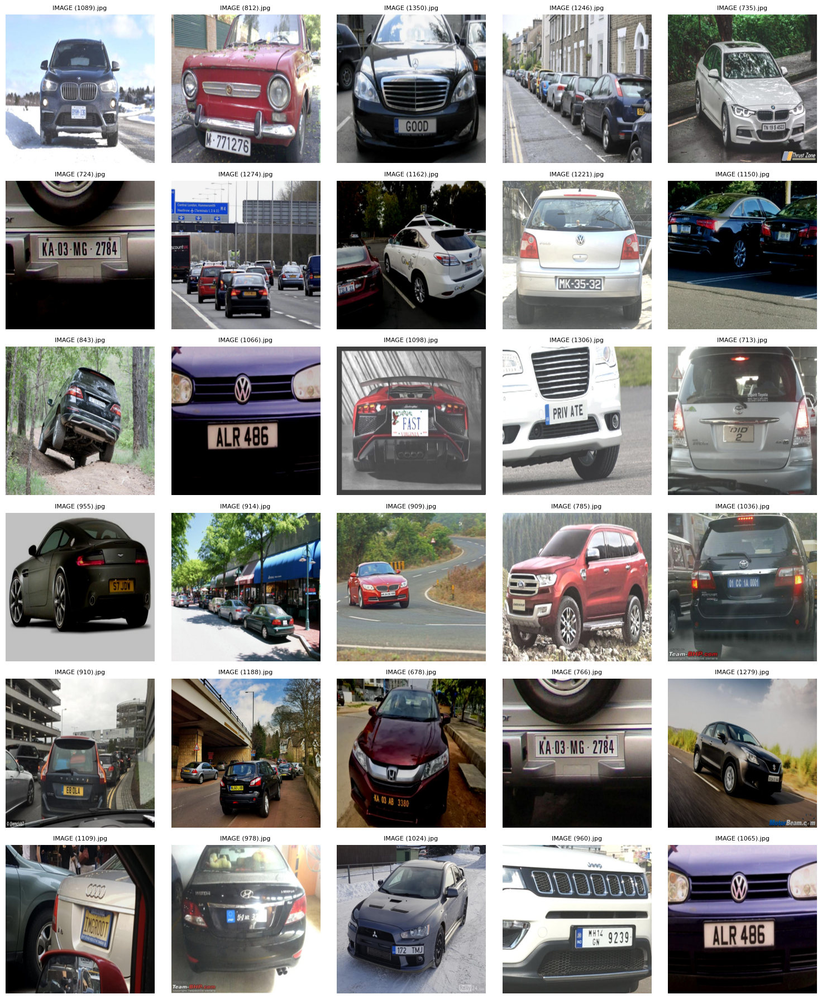

In [4]:
# Chemin du dossier contenant les images
dataset_path = '../MEMOIRE/ANPR_DATASET'

# Récupérer la liste des fichiers images
image_files = [f for f in os.listdir(dataset_path) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]

# Sélectionner 30 images aléatoires (limité au nombre total si < 30)
num_images = min(30, len(image_files))
random_image_files = random.sample(image_files, num_images)

# Calculer le nombre de lignes et colonnes pour afficher 30 images
cols = 5
rows = (num_images + cols - 1) // cols  # Ajuster dynamiquement les lignes
plt.figure(figsize=(15, 3 * rows))  # Ajuster la taille en fonction des lignes

# Affichage des images originales
for i, file in enumerate(random_image_files):
    image_path = os.path.join(dataset_path, file)
    img = cv2.imread(image_path)
    
    if img is None:
        print(f"Erreur de chargement : {file}")
        continue

    # Convertir de BGR (OpenCV) à RGB (Matplotlib)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    plt.subplot(rows, cols, i + 1)  # Grille dynamique
    plt.imshow(img_rgb)
    plt.title(f"{file}", fontsize=8)
    plt.axis('off')

plt.tight_layout()
plt.show()

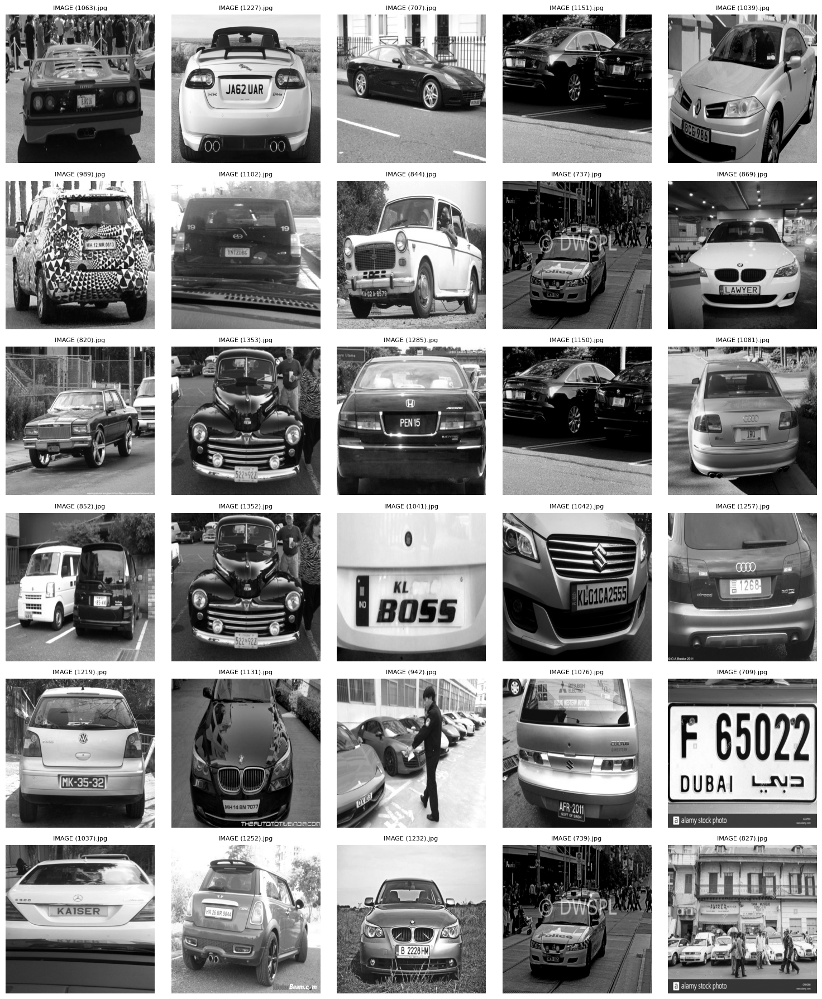

In [5]:

# Définir le dossier contenant les plaques
plaque_folder = '../MEMOIRE/ANPR_DATASET'

# Extensions d'image valides
valid_extensions = ('.jpg', '.jpeg', '.png', '.bmp', '.tif', '.tiff')

# Récupérer les fichiers image valides
image_files = [f for f in os.listdir(plaque_folder) if f.lower().endswith(valid_extensions)]

# Sélectionner 30 images aléatoires (limité au nombre total si < 30)
num_images = min(30, len(image_files))
random_image_files = random.sample(image_files, num_images)

# Calculer le nombre de lignes et colonnes pour afficher 30 images
cols = 5
rows = (num_images + cols - 1) // cols  # Ajuster dynamiquement les lignes
plt.figure(figsize=(15, 3 * rows))  # Ajuster la taille en fonction des lignes

# Affichage des images en niveaux de gris
for i, file in enumerate(random_image_files):
    image_path = os.path.join(plaque_folder, file)
    img = cv2.imread(image_path)
    
    if img is None:
        print(f"Erreur de chargement : {file}")
        continue

    # Convertir en niveaux de gris
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    plt.subplot(rows, cols, i + 1)  # Grille dynamique
    plt.imshow(gray, cmap='gray')
    plt.title(f"{file}", fontsize=8)
    plt.axis('off')

plt.tight_layout()
plt.show()


In [6]:
from PIL import Image

# Récupérer la liste des fichiers images
image_files = [f for f in os.listdir(dataset_path) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]

# Créer la liste des chemins complets des images
plaque = [os.path.join(dataset_path, f) for f in image_files]

# Listes pour stocker les caractéristiques et les étiquettes
features = []
targets = []

# Exemple : boucle pour une classe (toutes les images sont de la classe "plaque")
for file in plaque:
    try:
        # Ouvrir et redimensionner l'image
        image = Image.open(file).resize((75, 75))  # Taille fixe, ajustable
        features.append(np.array(image))
        targets.append([1, 0])  # Étiquette pour la classe "plaque" (ex. [1, 0])
    except Exception as e:
        print(f"Erreur avec {file} : {e}")

# Conversion en tableaux numpy
features = np.array(features)
targets = np.array(targets)

# Affichage des formes
print("features shape:", features.shape)
print("targets shape:", targets.shape)

features shape: (695, 75, 75, 3)
targets shape: (695, 2)


In [7]:
print("Nombre total d'échantillons :", len(features))

Nombre total d'échantillons : 695


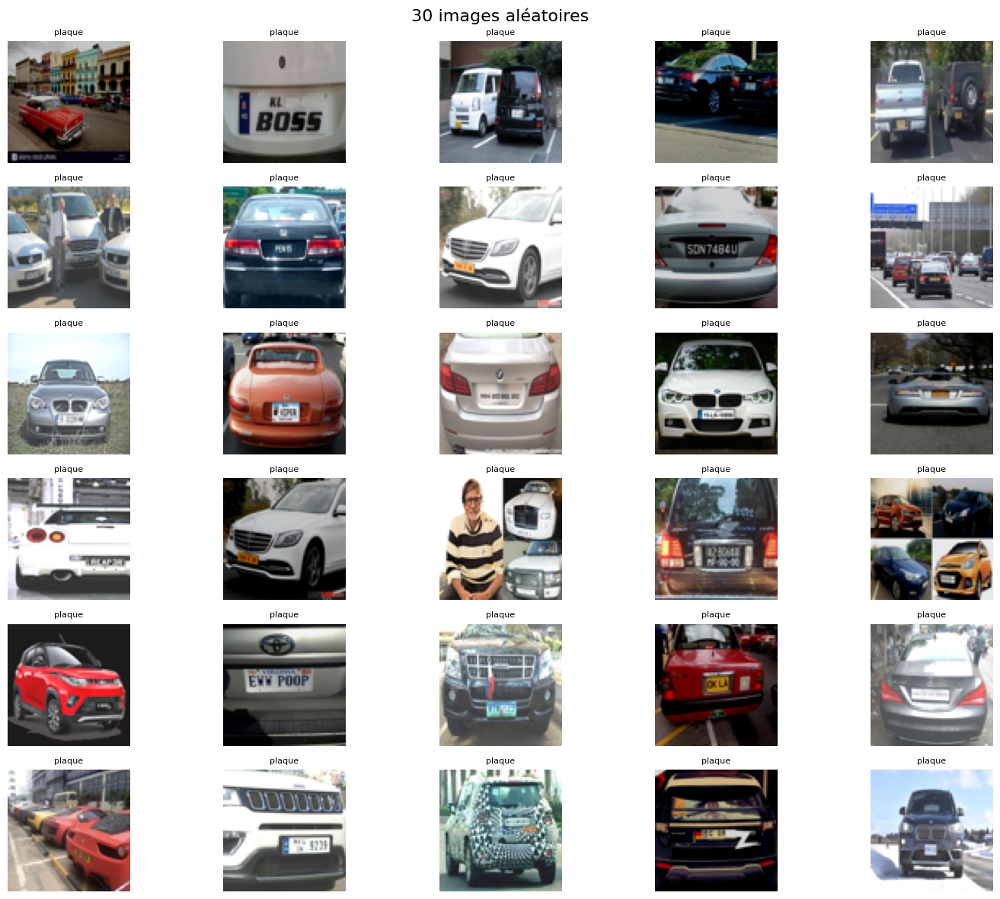

In [8]:
import numpy as np
import matplotlib.pyplot as plt
import random

# 30 indices aléatoires
indices = random.sample(range(len(features)), min(30, len(features)))  # Limite à 30 ou au nombre total d'images

plt.figure(figsize=(15, 12))  # Ajuster la taille pour 30 images

for i, idx in enumerate(indices):
    img = features[idx]
    label = targets[idx]

    # Décodage du label
    label_text = "plaque" if np.array_equal(label, [1, 0]) else "voiture"

    # Affichage
    plt.subplot(6, 5, i + 1)  # 6 lignes, 5 colonnes pour 30 images
    plt.imshow(img.astype('uint8'))  # Affiche l'image
    plt.title(label_text, fontsize=8)  # Réduire la taille de la police pour éviter le chevauchement
    plt.axis('off')

plt.suptitle("30 images aléatoires", fontsize=16)
plt.tight_layout()
plt.show()

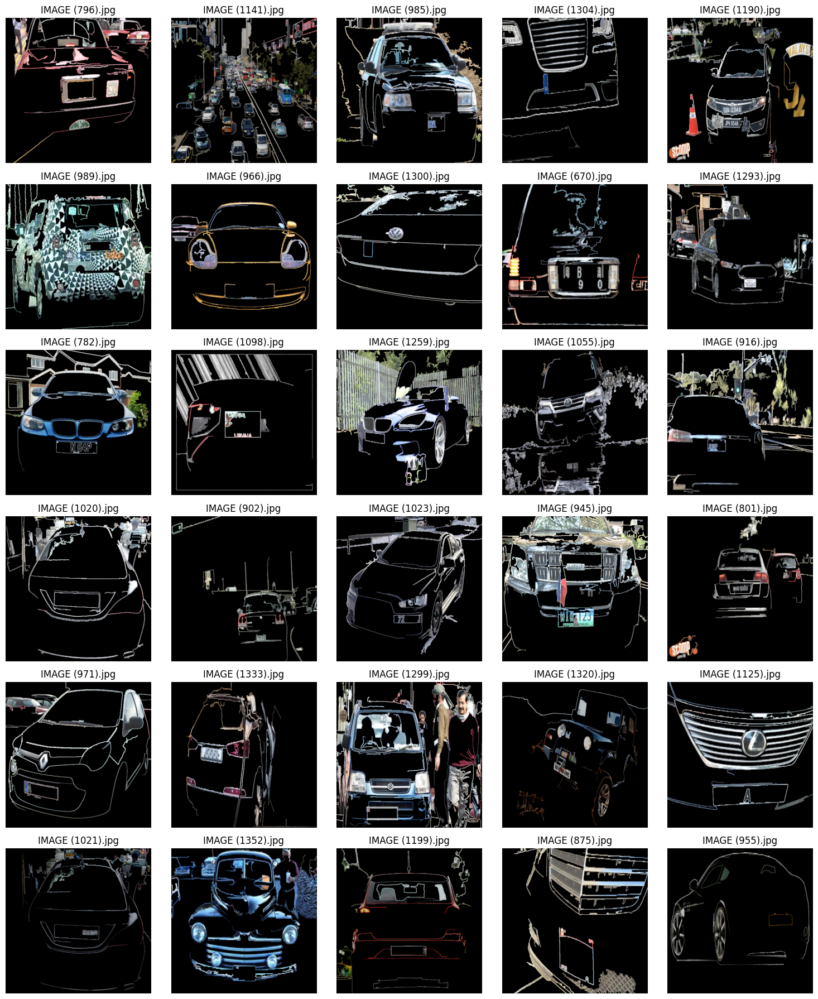

In [9]:

# Sélectionner 30 images aléatoires (limité au nombre total si < 30)
num_images = min(30, len(image_files))
random_image_files = random.sample(image_files, num_images)

# Calculer le nombre de lignes et colonnes pour afficher 30 images
cols = 5
rows = (num_images + cols - 1) // cols  # Ajuster dynamiquement les lignes
plt.figure(figsize=(15, 3 * rows))  # Ajuster la taille en fonction des lignes

for i, file in enumerate(random_image_files):
    image_path = os.path.join(dataset_path, file)
    image = cv2.imread(image_path)

    if image is None:
        print(f"[ERREUR] Impossible de lire : {file}")
        continue

    # Convertir en niveaux de gris
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Réduction de bruit
    bfilter = cv2.bilateralFilter(gray, 11, 17, 17)

    # Détection des bords
    edged = cv2.Canny(bfilter, 30, 200)

    # Dilatation pour renforcer les contours
    kernel = np.ones((3, 3), np.uint8)
    dilated = cv2.dilate(edged, kernel, iterations=1)

    # Détection des contours
    contours, _ = cv2.findContours(dilated, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    contours = sorted(contours, key=cv2.contourArea, reverse=True)[:10]  # Prendre les 10 plus grands contours

    # Créer une copie de l'image originale pour dessiner les contours
    contour_image = image.copy()

    # Filtrer les contours pour détecter les quadrilatères (plaques)
    for contour in contours:
        approx = cv2.approxPolyDP(contour, 3, True)
        if len(approx) == 4:  # Si c'est un quadrilatère
            cv2.drawContours(contour_image, [approx], -1, (0, 255, 0), 2)

    # Créer un masque
    mask = np.zeros_like(gray)
    cv2.drawContours(mask, contours, -1, 255, -1)
    masked_image = cv2.bitwise_and(image, image, mask=mask)

    # Afficher l'image masquée avec les contours
    plt.subplot(rows, cols, i + 1)
    plt.imshow(cv2.cvtColor(masked_image, cv2.COLOR_BGR2RGB))
    plt.title(file)
    plt.axis('off')

plt.tight_layout()
plt.show()

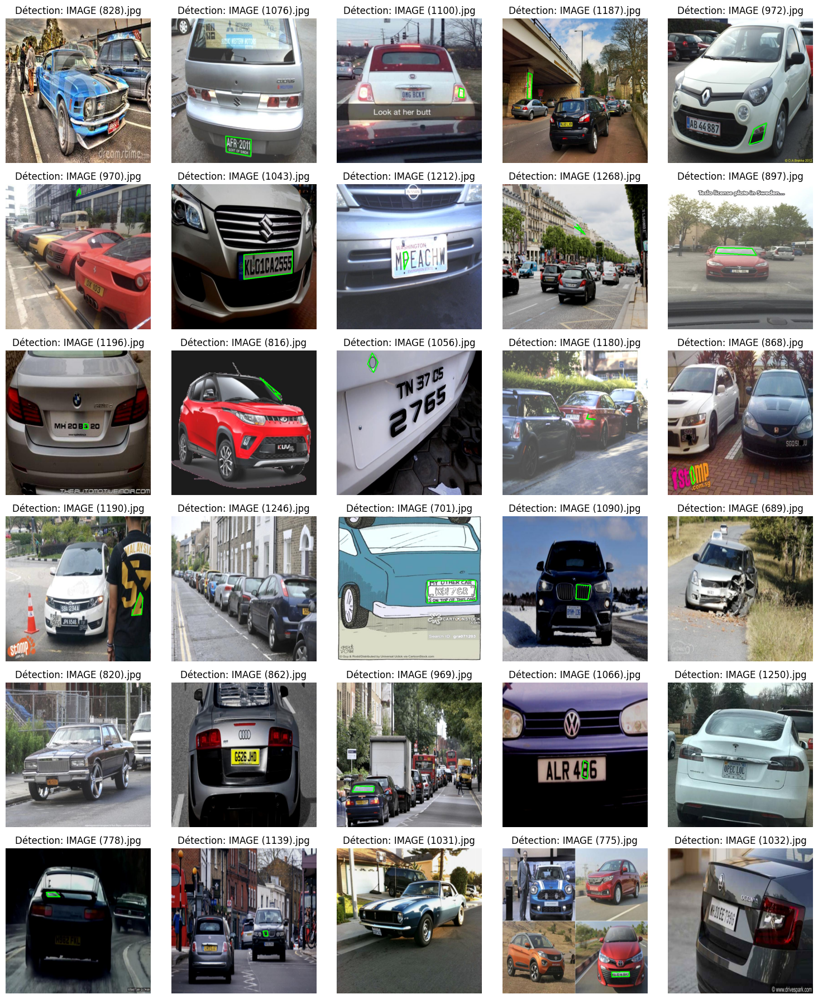

In [10]:

output_path = '../MEMOIRE/plates_detected'
os.makedirs(output_path, exist_ok=True)

# Récupérer la liste des fichiers images
image_files = [f for f in os.listdir(dataset_path) if f.endswith(('.jpg', '.jpeg', '.png'))]

# Sélectionner 30 images aléatoires (limité au nombre total si < 30)
num_images = min(30, len(image_files))
random_image_files = random.sample(image_files, num_images)

# Calculer le nombre de lignes et colonnes pour afficher 30 images
cols = 5
rows = (num_images + cols - 1) // cols  # Ajuster dynamiquement les lignes
plt.figure(figsize=(15, 3 * rows))  # Ajuster la taille en fonction des lignes

for i, file in enumerate(random_image_files):
    image_path = os.path.join(dataset_path, file)
    image = cv2.imread(image_path)

    if image is None:
        print(f"[ERREUR] Impossible de lire : {file}")
        continue

    # Étapes de prétraitement
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)
    edged = cv2.Canny(blurred, 30, 200)

    # Détection des contours
    contours, _ = cv2.findContours(edged.copy(), cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    contours = sorted(contours, key=cv2.contourArea, reverse=True)[:10]

    # Recherche du contour ayant 4 points
    location = None
    for contour in contours:
        approx = cv2.approxPolyDP(contour, 10, True)
        if len(approx) == 4:
            location = approx
            break

    # Dessin du rectangle détecté (si trouvé)
    image_with_contour = image.copy()
    if location is not None:
        cv2.drawContours(image_with_contour, [location], -1, (0, 255, 0), 3)

    # Sauvegarde dans le dossier de sortie
    save_path = os.path.join(output_path, file)
    cv2.imwrite(save_path, image_with_contour)

    # Afficher l'image avec les contours dans une grille
    plt.subplot(rows, cols, i + 1)
    plt.imshow(cv2.cvtColor(image_with_contour, cv2.COLOR_BGR2RGB))
    plt.title(f'Détection: {file}')
    plt.axis('off')

plt.tight_layout()
plt.show()

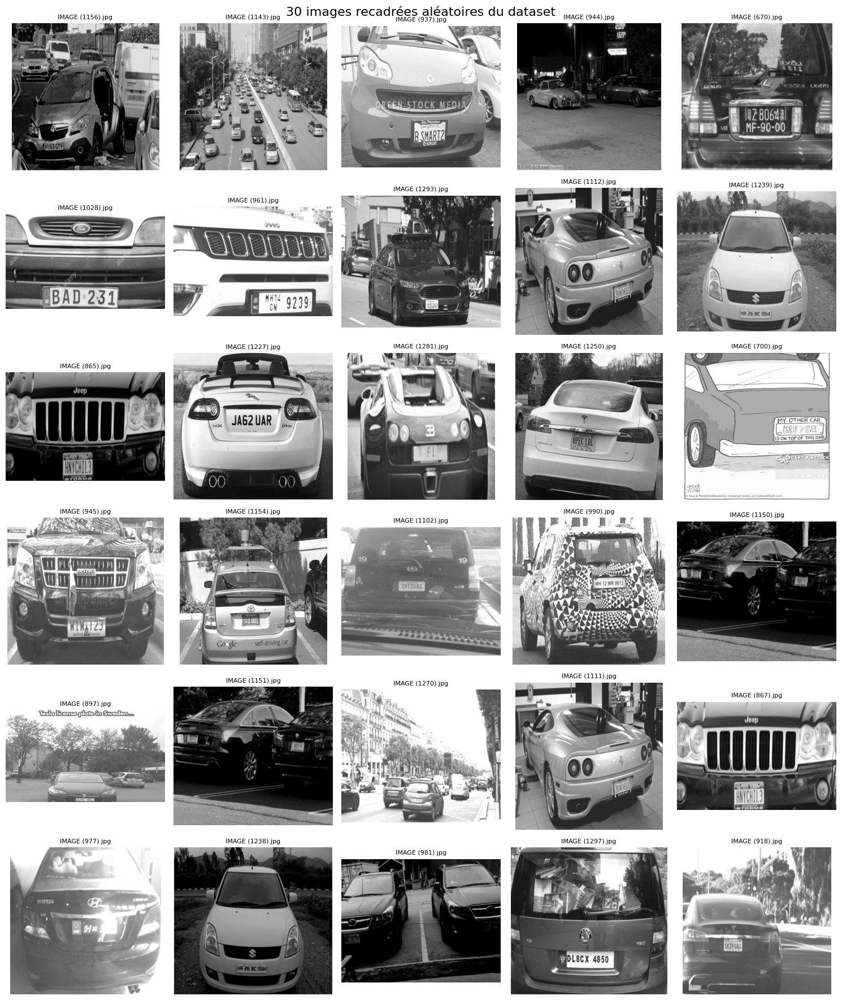

In [11]:

# Sélectionner 30 images aléatoires (limité au nombre total si < 30)
num_images = min(30, len(image_files))
random_image_files = random.sample(image_files, num_images)

# Calculer le nombre de lignes et colonnes pour afficher les images
cols = 5
rows = (num_images + cols - 1) // cols  # Ajuster dynamiquement les lignes
plt.figure(figsize=(15, 3 * rows))  # Ajuster la taille en fonction des lignes

# Affichage des images recadrées
for i, file in enumerate(random_image_files):
    image_path = os.path.join(dataset_path, file)
    image = cv2.imread(image_path)  # Charger l'image en BGR
    
    if image is None:
        print(f"Erreur de chargement : {file}")
        continue

    # Convertir en niveaux de gris
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Réduction de bruit
    bfilter = cv2.bilateralFilter(gray, 11, 17, 17)

    # Détection des bords
    edged = cv2.Canny(bfilter, 30, 200)

    # Dilatation pour renforcer les contours
    kernel = np.ones((3, 3), np.uint8)
    dilated = cv2.dilate(edged, kernel, iterations=1)

    # Détection des contours
    contours, _ = cv2.findContours(dilated, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    contours = sorted(contours, key=cv2.contourArea, reverse=True)[:10]  # Prendre les 10 plus grands contours

    # Créer un masque
    mask = np.zeros_like(gray)
    if contours:
        cv2.drawContours(mask, contours, -1, 255, -1)

    # Trouver les coordonnées des pixels où le masque est 255
    (x, y) = np.where(mask == 255)
    if len(x) > 0 and len(y) > 0:  # Vérifier qu'il y a des pixels détectés
        (x1, y1) = (np.min(x), np.min(y))
        (x2, y2) = (np.max(x), np.max(y))
        cropped_image = gray[x1:x2+1, y1:y2+1]
    else:
        cropped_image = gray  # Si aucun contour, utiliser l'image entière

    # Convertir de BGR à RGB (bien que cropped_image soit en niveaux de gris, on ajuste pour RGB si besoin)
    if len(cropped_image.shape) == 2:  # Si en niveaux de gris
        img_rgb = cv2.cvtColor(cv2.cvtColor(cropped_image, cv2.COLOR_GRAY2BGR), cv2.COLOR_BGR2RGB)
    else:
        img_rgb = cv2.cvtColor(cropped_image, cv2.COLOR_BGR2RGB)

    # Affichage
    plt.subplot(rows, cols, i + 1)
    plt.imshow(img_rgb)
    plt.title(f"{file}", fontsize=8)
    plt.axis('off')

plt.suptitle("30 images recadrées aléatoires du dataset", fontsize=16)
plt.tight_layout()
plt.show()

Neither CUDA nor MPS are available - defaulting to CPU. Note: This module is much faster with a GPU.
C:\Users\User\anaconda3\envs\env5\lib\site-packages\torch\utils\data\dataloader.py:665: UserWarning: 'pin_memory' argument is set as true but no accelerator is found, then device pinned memory won't be used.
  warnings.warn(warn_msg)


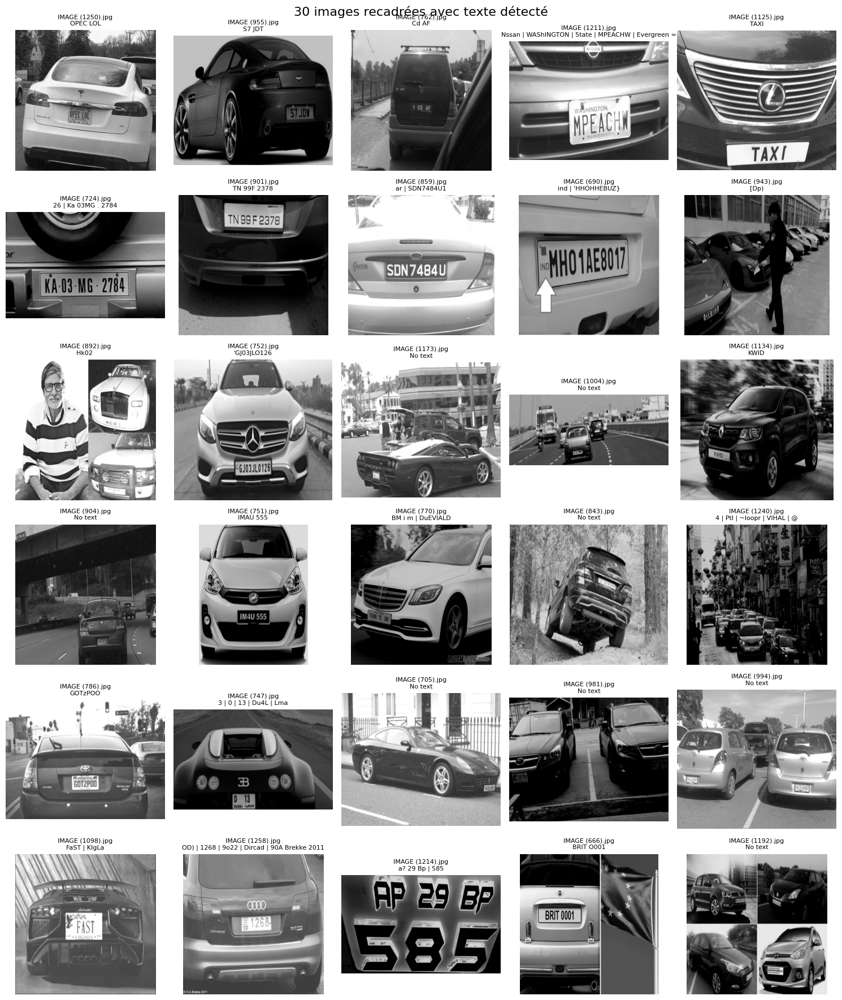

Image: IMAGE (1250).jpg
Texte détecté : [([[np.int32(242), np.int32(360)], [np.int32(344), np.int32(360)], [np.int32(344), np.int32(412)], [np.int32(242), np.int32(412)]], 'OPEC LOL', np.float64(0.7720962799447819))]
Image: IMAGE (955).jpg
Texte détecté : [([[np.int32(440), np.int32(270)], [np.int32(526), np.int32(270)], [np.int32(526), np.int32(320)], [np.int32(440), np.int32(320)]], 'S7 JDT', np.float64(0.19613517565517252))]
Image: IMAGE (762).jpg
Texte détecté : [([[np.int32(298), np.int32(338)], [np.int32(366), np.int32(338)], [np.int32(366), np.int32(370)], [np.int32(298), np.int32(370)]], 'Cd AF', np.float64(0.4998519561697217))]
Image: IMAGE (1211).jpg
Texte détecté : [([[np.int32(309), np.int32(25)], [np.int32(367), np.int32(25)], [np.int32(367), np.int32(41)], [np.int32(309), np.int32(41)]], 'Nssan', np.float64(0.04507326285434209)), ([[np.int32(254), np.int32(250)], [np.int32(405), np.int32(250)], [np.int32(405), np.int32(301)], [np.int32(254), np.int32(301)]], 'WAShINGTON',

In [12]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os
import random
import easyocr

# Initialiser le lecteur easyocr pour l'anglais
reader = easyocr.Reader(['en'])

# Chemin du dossier contenant les images
dataset_path = '../MEMOIRE/ANPR_DATASET'  # Remplacez par le chemin réel de votre dataset

# Récupérer la liste des fichiers images
image_files = [f for f in os.listdir(dataset_path) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]

# Sélectionner 30 images aléatoires (limité au nombre total si < 30)
num_images = min(30, len(image_files))
random_image_files = random.sample(image_files, num_images)

# Calculer le nombre de lignes et colonnes pour afficher les images
cols = 5
rows = (num_images + cols - 1) // cols  # Ajuster dynamiquement les lignes
plt.figure(figsize=(15, 3 * rows))  # Ajuster la taille en fonction des lignes

# Affichage et traitement des images
for i, file in enumerate(random_image_files):
    image_path = os.path.join(dataset_path, file)
    image = cv2.imread(image_path)  # Charger l'image en BGR
    
    if image is None:
        print(f"Erreur de chargement : {file}")
        continue

    # Convertir en niveaux de gris
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Réduction de bruit
    bfilter = cv2.bilateralFilter(gray, 11, 17, 17)

    # Détection des bords
    edged = cv2.Canny(bfilter, 30, 200)

    # Dilatation pour renforcer les contours
    kernel = np.ones((3, 3), np.uint8)
    dilated = cv2.dilate(edged, kernel, iterations=1)

    # Détection des contours
    contours, _ = cv2.findContours(dilated, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    contours = sorted(contours, key=cv2.contourArea, reverse=True)[:10]  # Prendre les 10 plus grands contours

    # Créer un masque
    mask = np.zeros_like(gray)
    if contours:
        cv2.drawContours(mask, contours, -1, 255, -1)

    # Trouver les coordonnées des pixels où le masque est 255
    (x, y) = np.where(mask == 255)
    if len(x) > 0 and len(y) > 0:  # Vérifier qu'il y a des pixels détectés
        (x1, y1) = (np.min(x), np.min(y))
        (x2, y2) = (np.max(x), np.max(y))
        cropped_image = gray[x1:x2+1, y1:y2+1]
    else:
        cropped_image = gray  # Si aucun contour, utiliser l'image entière

    # Appliquer easyocr pour lire le texte
    result = reader.readtext(cropped_image)
    text_detected = "No text" if not result else " | ".join([item[1] for item in result])

    # Convertir l'image recadrée pour affichage (niveaux de gris à RGB)
    if len(cropped_image.shape) == 2:  # Si en niveaux de gris
        img_rgb = cv2.cvtColor(cv2.cvtColor(cropped_image, cv2.COLOR_GRAY2BGR), cv2.COLOR_BGR2RGB)
    else:
        img_rgb = cv2.cvtColor(cropped_image, cv2.COLOR_BGR2RGB)

    # Affichage
    plt.subplot(rows, cols, i + 1)
    plt.imshow(img_rgb)
    plt.title(f"{file}\n{text_detected}", fontsize=8)
    plt.axis('off')

plt.suptitle("30 images recadrées avec texte détecté", fontsize=16)
plt.tight_layout()
plt.show()

# Afficher les résultats détaillés dans la console
for i, file in enumerate(random_image_files):
    print(f"Image: {file}")
    image_path = os.path.join(dataset_path, file)
    image = cv2.imread(image_path)
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    bfilter = cv2.bilateralFilter(gray, 11, 17, 17)
    edged = cv2.Canny(bfilter, 30, 200)
    kernel = np.ones((3, 3), np.uint8)
    dilated = cv2.dilate(edged, kernel, iterations=1)
    contours, _ = cv2.findContours(dilated, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    contours = sorted(contours, key=cv2.contourArea, reverse=True)[:10]
    mask = np.zeros_like(gray)
    if contours:
        cv2.drawContours(mask, contours, -1, 255, -1)
    (x, y) = np.where(mask == 255)
    if len(x) > 0 and len(y) > 0:
        (x1, y1) = (np.min(x), np.min(y))
        (x2, y2) = (np.max(x), np.max(y))
        cropped_image = gray[x1:x2+1, y1:y2+1]
    else:
        cropped_image = gray
    result = reader.readtext(cropped_image)
    print(f"Texte détecté : {result}")

Neither CUDA nor MPS are available - defaulting to CPU. Note: This module is much faster with a GPU.


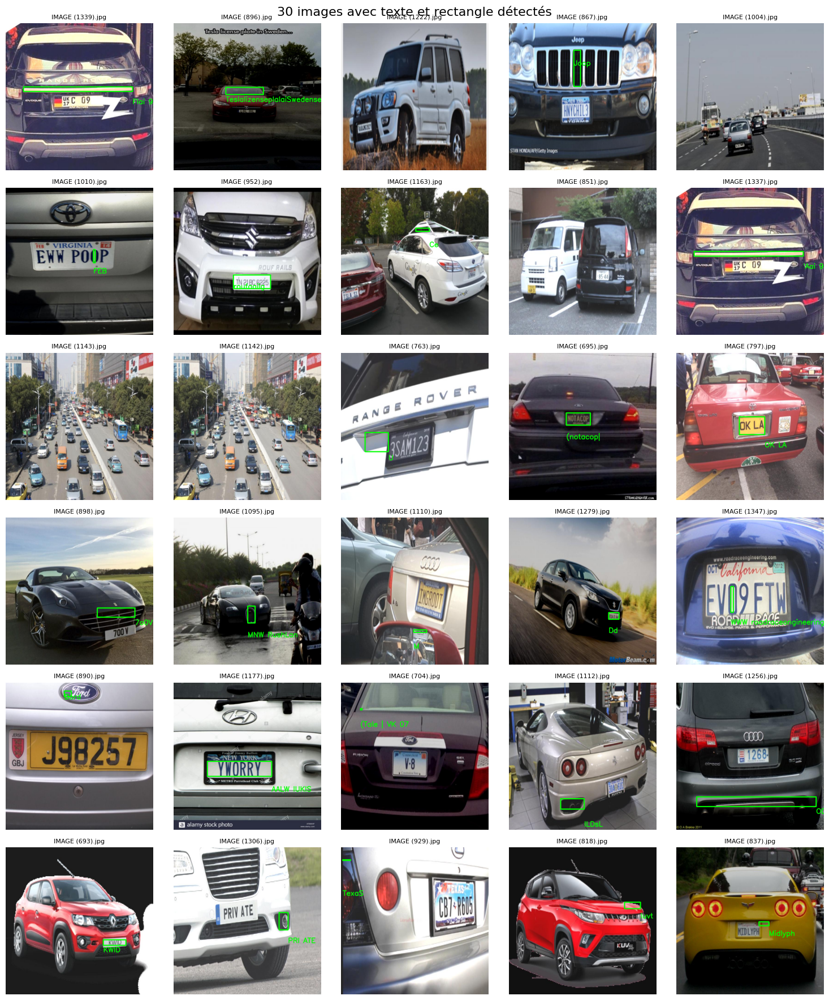

In [13]:

# Initialiser le lecteur easyocr pour l'anglais
reader = easyocr.Reader(['en'])

# Chemin du dossier contenant les images
dataset_path = '../MEMOIRE/ANPR_DATASET'  # Remplacez par le chemin réel de votre dataset

# Récupérer la liste des fichiers images
image_files = [f for f in os.listdir(dataset_path) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]

# Sélectionner 30 images aléatoires (limité au nombre total si < 30)
num_images = min(30, len(image_files))
random_image_files = random.sample(image_files, num_images)

# Calculer le nombre de lignes et colonnes pour afficher les images
cols = 5
rows = (num_images + cols - 1) // cols  # Ajuster dynamiquement les lignes
plt.figure(figsize=(15, 3 * rows))  # Ajuster la taille en fonction des lignes

# Police pour le texte
font = cv2.FONT_HERSHEY_SIMPLEX

# Affichage et traitement des images
for i, file in enumerate(random_image_files):
    image_path = os.path.join(dataset_path, file)
    img = cv2.imread(image_path)  # Charger l'image en BGR
    
    if img is None:
        print(f"Erreur de chargement : {file}")
        continue

    # Convertir en niveaux de gris
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Réduction de bruit
    bfilter = cv2.bilateralFilter(gray, 11, 17, 17)

    # Détection des bords
    edged = cv2.Canny(bfilter, 30, 200)

    # Dilatation pour renforcer les contours
    kernel = np.ones((3, 3), np.uint8)
    dilated = cv2.dilate(edged, kernel, iterations=1)

    # Détection des contours
    contours, _ = cv2.findContours(dilated, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    contours = sorted(contours, key=cv2.contourArea, reverse=True)[:10]  # Prendre les 10 plus grands contours

    # Vérifier s'il y a des contours
    approx = None
    for contour in contours:
        approx = cv2.approxPolyDP(contour, 10, True)
        if len(approx) == 4:  # Si c'est un quadrilatère
            break

    # Appliquer easyocr pour lire le texte
    result = reader.readtext(gray) if contours else []
    text = result[0][-2] if result else "No text"

    # Créer une copie de l'image pour les annotations
    res = img.copy()

    # Ajouter le texte si approx est défini
    if approx is not None and result:
        res = cv2.putText(res, text=text, org=(approx[0][0][0], approx[1][0][1] + 60), 
                          fontFace=font, fontScale=1, color=(0, 255, 0), thickness=2, lineType=cv2.LINE_AA)
        res = cv2.rectangle(res, tuple(approx[0][0]), tuple(approx[2][0]), (0, 255, 0), 3)

    # Convertir de BGR à RGB pour affichage
    img_rgb = cv2.cvtColor(res, cv2.COLOR_BGR2RGB)

    # Affichage
    plt.subplot(rows, cols, i + 1)
    plt.imshow(img_rgb)
    plt.title(f"{file}", fontsize=8)
    plt.axis('off')

plt.suptitle("30 images avec texte et rectangle détectés", fontsize=16)
plt.tight_layout()
plt.show()

In [14]:
# Séparation des données en ensembles d'entraînement et de test
from sklearn.model_selection import train_test_split
import numpy as np

X_train, X_test = train_test_split(images, test_size=0.2, random_state=42)

# Normalisation (déjà effectuée, confirmée ici)
X_train = X_train.astype('float32') / 255.0
X_test = X_test.astype('float32') / 255.0

In [15]:
# Ajout de variabilité aux images avec ImageDataGenerator
from tensorflow.keras.preprocessing.image import ImageDataGenerator
datagen = ImageDataGenerator(
    rotation_range=10,
    width_shift_range=0.1,
    height_shift_range=0.1,
    shear_range=0.1,
    zoom_range=0.1,
    horizontal_flip=True,
    fill_mode='nearest'
)
datagen.fit(X_train)


In [16]:
# Création du modèle CNN avec 20 couches
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Dropout, Flatten, Dense, BatchNormalization
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint

model = Sequential([
    Conv2D(32, (3, 3), activation='relu', input_shape=(224, 224, 3), padding='same'),
    BatchNormalization(),
    Conv2D(32, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    MaxPooling2D((2, 2)),
    Dropout(0.25),

    Conv2D(64, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    Conv2D(64, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    MaxPooling2D((2, 2)),
    Dropout(0.25),

    Conv2D(128, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    Conv2D(128, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    MaxPooling2D((2, 2)),
    Dropout(0.25),

    Conv2D(256, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    Conv2D(256, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    MaxPooling2D((2, 2)),
    Dropout(0.25),

    Conv2D(512, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    Conv2D(512, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    MaxPooling2D((2, 2)),
    Dropout(0.25),

    Flatten(),
    Dense(1024, activation='relu'),
    BatchNormalization(),
    Dropout(0.5),
    Dense(512, activation='relu'),
    BatchNormalization(),
    Dropout(0.5),
    Dense(1, activation='sigmoid')  # Sortie binaire
])


C:\Users\User\anaconda3\envs\env5\lib\site-packages\keras\src\layers\convolutional\base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


In [17]:
# Compilation du modèle
model.compile(optimizer=Adam(learning_rate=0.001), loss='binary_crossentropy', metrics=['accuracy'])

In [18]:
# Callbacks pour arrêter l'entraînement automatiquement
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
checkpoint = ModelCheckpoint('best_model.h5', monitor='val_accuracy', save_best_only=True, mode='max')

In [19]:

# Entraînement du modèle
history = model.fit(datagen.flow(X_train, np.zeros(len(X_train)), batch_size=32),
                    epochs=50,
                    validation_data=(X_test, np.zeros(len(X_test))),
                    callbacks=[early_stopping, checkpoint])


C:\Users\User\anaconda3\envs\env5\lib\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/50
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 6s/step - accuracy: 0.5025 - loss: 1.0695

18/18 ━━━━━━━━━━━━━━━━━━━━ 137s 7s/step - accuracy: 0.5051 - loss: 1.0640 - val_accuracy: 1.0000 - val_loss: 0.5592
Epoch 2/50
18/18 ━━━━━━━━━━━━━━━━━━━━ 120s 7s/step - accuracy: 0.6520 - loss: 0.6448 - val_accuracy: 1.0000 - val_loss: 0.0277
Epoch 3/50
18/18 ━━━━━━━━━━━━━━━━━━━━ 126s 7s/step - accuracy: 0.7750 - loss: 0.5380 - val_accuracy: 0.0000e+00 - val_loss: 2.1805
Epoch 4/50
18/18 ━━━━━━━━━━━━━━━━━━━━ 120s 7s/step - accuracy: 0.8315 - loss: 0.4236 - val_accuracy: 1.0000 - val_loss: 0.6017
Epoch 5/50
18/18 ━━━━━━━━━━━━━━━━━━━━ 121s 7s/step - accuracy: 0.8755 - loss: 0.3161 - val_accuracy: 0.0000e+00 - val_loss: 0.8689
Epoch 6/50
18/18 ━━━━━━━━━━━━━━━━━━━━ 58407s 3435s/step - accuracy: 0.9107 - loss: 0.2469 - val_accuracy: 1.0000 - val_loss: 0.0534
Epoch 7/50
18/18 ━━━━━━━━━━━━━━━━━━━━ 93s 5s/step - accuracy: 0.9559 - loss: 0.2116 - val_accuracy: 0.0000e+00 - val_loss: 1.4507


In [20]:
# Prédiction sur les données de test
predictions = model.predict(X_test)
print("Prédictions :", predictions)

5/5 ━━━━━━━━━━━━━━━━━━━━ 8s 1s/step
Prédictions : [[0.02735911]
 [0.02735092]
 [0.02735844]
 [0.02734216]
 [0.02734362]
 [0.0273481 ]
 [0.02735084]
 [0.02735463]
 [0.02735305]
 [0.0273426 ]
 [0.02735856]
 [0.02736012]
 [0.02736233]
 [0.02736761]
 [0.02734877]
 [0.02734898]
 [0.02735501]
 [0.02735004]
 [0.02735571]
 [0.02735693]
 [0.027349  ]
 [0.02736245]
 [0.02735618]
 [0.02735039]
 [0.0273441 ]
 [0.02735523]
 [0.0273613 ]
 [0.02736776]
 [0.02735524]
 [0.02735796]
 [0.0273532 ]
 [0.02735577]
 [0.02735368]
 [0.02735587]
 [0.02735267]
 [0.02734726]
 [0.02735171]
 [0.02736183]
 [0.02735275]
 [0.02735579]
 [0.02737502]
 [0.02734271]
 [0.02734327]
 [0.02735858]
 [0.02735108]
 [0.02733926]
 [0.02736139]
 [0.02735577]
 [0.02735697]
 [0.02733723]
 [0.02735009]
 [0.0273479 ]
 [0.02736386]
 [0.02734877]
 [0.02734461]
 [0.02734509]
 [0.02735034]
 [0.02735548]
 [0.02735188]
 [0.02734675]
 [0.02735086]
 [0.02735222]
 [0.02735237]
 [0.02736108]
 [0.0273497 ]
 [0.02734247]
 [0.02734504]
 [0.02736142